In [2]:
import pickle

f = open('possibly_died.pkl', 'rb')
possibly_died = pickle.load(f)
f.close()

In [3]:
import numpy as np
import deepcell_tracking.utils as tracking
from deepcell_tracking.utils import Track
from pathlib import Path

file_name = Path("/data/3T3_HeLa_HEK_RAW_V2.trks")
cell_tracks = Track(file_name)

cell_tracks._correct_lineages()
cell_tracks._remove_invalid_batches()

In [4]:
from skimage.io import imread, imsave, imshow
import matplotlib.pyplot as plt

In [5]:
def get_borders(batch_num):
    x_min = 0
    x_max = 0
    y_min = 0
    y_max = 0
    for x in range(cell_tracks.X.shape[2]):
        if cell_tracks.X[batch_num][0][x][100] != 0:
            x_min = x - 1
            break
    for x in range(cell_tracks.X.shape[2] - 1, -1, -1):
        if cell_tracks.X[batch_num][0][x][100] != 0:
            x_max = x + 1
            break
    for y in range(cell_tracks.X.shape[3]):
        if cell_tracks.X[batch_num][0][100][y] != 0:
            y_min = y - 1
            break
    for y in range(cell_tracks.X.shape[3] - 1, -1 , -1):
        if cell_tracks.X[batch_num][0][100][y] != 0:
            y_max = y + 1
            break
    return x_min, x_max, y_min, y_max

def get_last_frame(batch_num):
    last_frame = 0
    #frames are numbered as per their indices
    for frame in range(cell_tracks.centroids.shape[1] - 1, -1, -1):
        if not np.array_equal(cell_tracks.centroids[batch_num][frame], np.zeros((39, 2))):
            last_frame = frame
            break
    return last_frame

def get_dead_cells_centroid(dist):
    died = {}
    for batch_num in possibly_died:
        x_min, x_max, y_min, y_max = get_borders(batch_num)
        died[batch_num] = {}
        for cell_num in possibly_died.get(batch_num):
            death_frame = possibly_died.get(batch_num).get(cell_num)
            centroid = cell_tracks.centroids[batch_num][death_frame][cell_num - 1]
            if x_min + dist <= centroid[0] <= x_max - dist and y_min + dist <= centroid[1] <= y_max - dist:
                died[batch_num][cell_num] = possibly_died.get(batch_num).get(cell_num)
    return died

def get_cell_list(cell_dict):
    cell_list = []
    for batch_num in cell_dict:
        for cell_num in cell_dict.get(batch_num):
            cell_list.append((batch_num, cell_num))
    return cell_list

In [6]:
died = get_dead_cells_centroid(10)

In [7]:
possibly_died

{0: {14: 12, 15: 22, 16: 23},
 1: {},
 2: {2: 24},
 3: {},
 4: {},
 5: {},
 6: {14: 0},
 7: {},
 8: {},
 9: {},
 10: {13: 19, 15: 25, 17: 25, 18: 4, 19: 4},
 11: {},
 12: {},
 13: {},
 14: {10: 8},
 15: {15: 23},
 16: {},
 17: {10: 25, 11: 9},
 18: {9: 1},
 19: {},
 20: {11: 13, 12: 22, 13: 4},
 21: {},
 22: {11: 18},
 23: {},
 24: {17: 18},
 25: {8: 4, 9: 22},
 26: {},
 27: {},
 28: {10: 25, 12: 20},
 29: {10: 15, 13: 23},
 30: {10: 28},
 31: {},
 32: {},
 33: {},
 34: {},
 35: {},
 36: {13: 16},
 37: {},
 38: {17: 23},
 39: {4: 24},
 40: {},
 41: {},
 42: {16: 26},
 43: {11: 14},
 44: {},
 45: {},
 46: {},
 47: {5: 24},
 48: {},
 49: {},
 50: {12: 12},
 51: {},
 52: {4: 21},
 53: {7: 16},
 54: {11: 19, 12: 28, 13: 7},
 55: {},
 56: {},
 57: {},
 58: {3: 25, 8: 5, 12: 19, 13: 25, 15: 13, 17: 14, 18: 20},
 59: {},
 60: {9: 8, 11: 14},
 61: {},
 62: {},
 63: {7: 11, 10: 28},
 64: {},
 65: {},
 66: {},
 67: {7: 5, 10: 26, 14: 13},
 68: {},
 69: {5: 27},
 70: {},
 71: {19: 15},
 72: {12: 

In [8]:
died

{0: {},
 1: {},
 2: {},
 3: {},
 4: {},
 5: {},
 6: {},
 7: {},
 8: {},
 9: {},
 10: {},
 11: {},
 12: {},
 13: {},
 14: {},
 15: {},
 16: {},
 17: {},
 18: {},
 19: {},
 20: {},
 21: {},
 22: {},
 23: {},
 24: {17: 18},
 25: {},
 26: {},
 27: {},
 28: {},
 29: {},
 30: {},
 31: {},
 32: {},
 33: {},
 34: {},
 35: {},
 36: {},
 37: {},
 38: {},
 39: {},
 40: {},
 41: {},
 42: {},
 43: {},
 44: {},
 45: {},
 46: {},
 47: {},
 48: {},
 49: {},
 50: {},
 51: {},
 52: {},
 53: {},
 54: {},
 55: {},
 56: {},
 57: {},
 58: {},
 59: {},
 60: {},
 61: {},
 62: {},
 63: {},
 64: {},
 65: {},
 66: {},
 67: {},
 68: {},
 69: {},
 70: {},
 71: {},
 72: {},
 73: {12: 23},
 74: {},
 75: {},
 76: {},
 77: {},
 78: {},
 79: {},
 80: {},
 81: {},
 82: {},
 83: {},
 84: {},
 85: {},
 86: {},
 87: {15: 27},
 88: {},
 89: {},
 90: {},
 91: {},
 92: {},
 93: {},
 94: {},
 95: {},
 96: {},
 97: {},
 98: {},
 99: {},
 100: {},
 101: {},
 102: {},
 103: {},
 104: {},
 105: {},
 106: {},
 107: {},
 108: {},
 1

In [9]:
possibly_died_cells = get_cell_list(possibly_died)
died_cells = get_cell_list(died)

In [10]:
len(possibly_died_cells)

1352

In [12]:
len(died_cells)

79

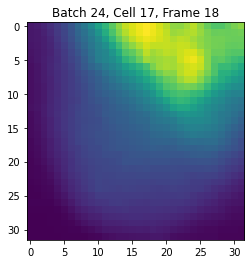

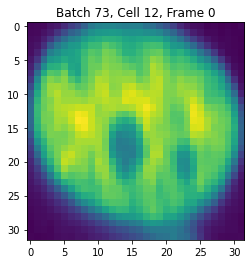

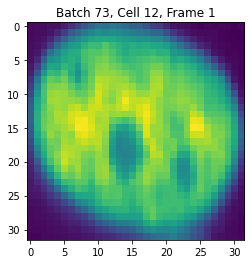

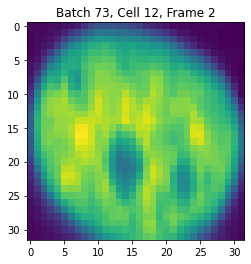

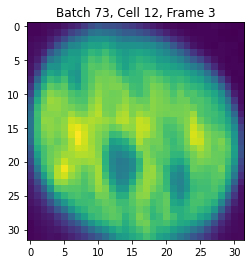

...

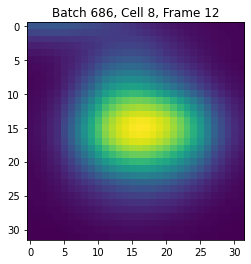

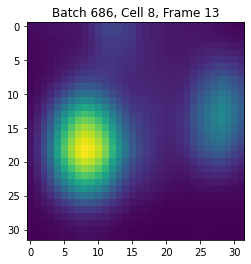

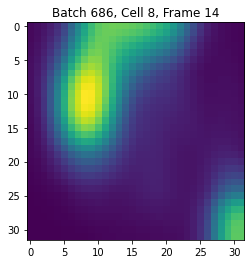

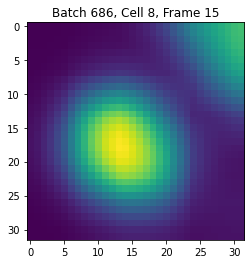

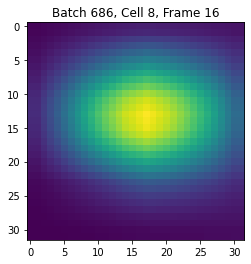

In [13]:
#Show appearances

import os

for batch in died:
    died_batch = died.get(batch)
    for cell in died_batch:
        for frame in cell_tracks.lineages[batch].get(cell).get('frames'):
            #results_dir = 'centroid_death_appearances/batch_{}/cell_{}/'.format(batch, cell)
            #if not os.path.isdir(results_dir):
            #    os.makedirs(results_dir)
            fig, ax = plt.subplots()
            ax.imshow(cell_tracks.appearances[batch][frame][cell - 1])
            ax.set_title('Batch {}, Cell {}, Frame {}'.format(batch, cell, frame))
            #plt.savefig(results_dir + 'batch_{}_cell_{}_frame_{}.jpg'.format(batch, cell, frame))
            plt.show()

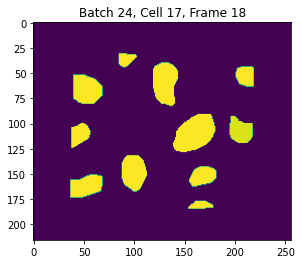

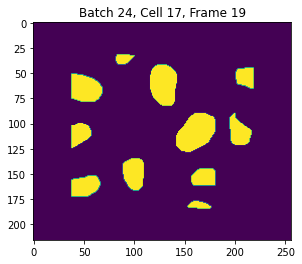

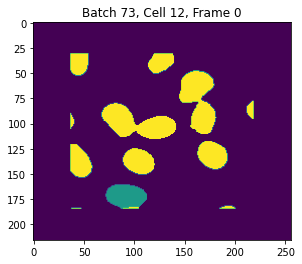

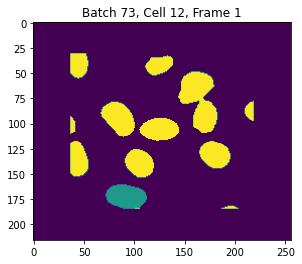

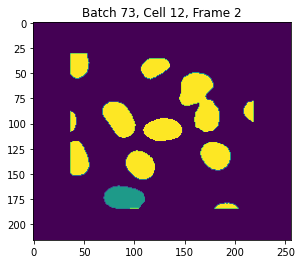

...

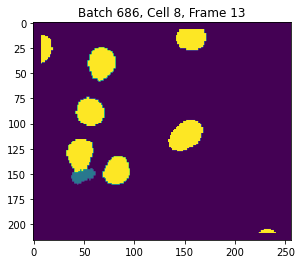

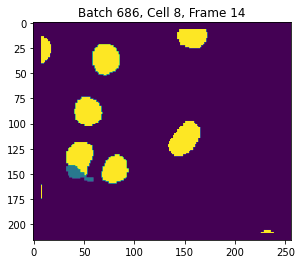

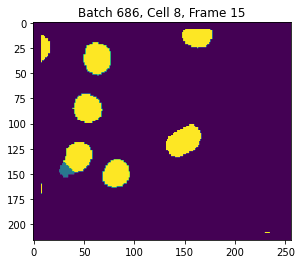

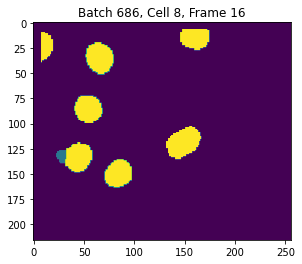

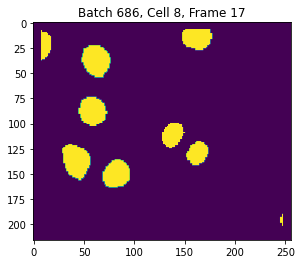

In [14]:
#Show label images

for batch in died:
    died_batch = died.get(batch)
    for cell in died_batch:
        frames = list(cell_tracks.lineages[batch].get(cell).get('frames'))
        frames.append(max(frames) + 1)
        for frame in frames:
            #results_dir = 'centroid_death_label_images/batch_{}/cell_{}/'.format(batch, cell)
            #if not os.path.isdir(results_dir):
            #    os.makedirs(results_dir)
            
            label_img = cell_tracks.y[batch][frame]

            spotlight_img = np.zeros((216, 256))
            for x in range(216):
                for y in range(256):
                    if label_img[x][y] == cell:
                        spotlight_img[x][y] = cell
                    elif label_img[x][y] != 0:
                        spotlight_img[x][y] = max(cell_tracks.lineages[batch].keys()) + 1
            
            fig, ax = plt.subplots()
            ax.imshow(spotlight_img)
            ax.set_title('Batch {}, Cell {}, Frame {}'.format(batch, cell, frame))
            #plt.savefig(results_dir + 'centroid_death_batch_{}_cell_{}_frame_{}.jpg'.format(batch, cell, frame))
            plt.show()

In [15]:
f = open('died_border_dist_10.pkl', 'wb')
pickle.dump(died, f)
f.close()

In [16]:
died = get_dead_cells_centroid(20)

In [ ]:
f = open('died_border_dist_10.pkl', 'wb')
pickle.dump(died, f)
f.close()